In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from copy import copy
from scipy import stats
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objects as go

In [2]:
# Get rid of the warning 
import warnings
warnings.filterwarnings("ignore")

In [3]:
fund_df = pd.read_csv(r'C:\Users\wmkoa\Downloads\Fund data\AIA\combined_fund_prices.csv')
fund_df['Date'] = pd.to_datetime(fund_df['Date'], dayfirst=True)
fund_df.set_index("Date", inplace = True)
fund_df

,65歲後基金_Price,大中華股票基金_Price,中港動態資產配置基金_Price,中港基金_Price,日本股票基金_Price,北美股票基金_Price,全球基金_Price,均衡組合_Price,亞洲股票基金_Price,亞洲債券基金_Price,...,基金經理精選退休基金_Price,強積金保守基金_Price,富達增長基金_Price,富達穩定資本基金_Price,富達穩定增長基金_Price,綠色退休基金_Price,增長組合_Price,歐洲股票基金_Price,環球債券基金_Price,穩定資本組合_Price
Date,,,,,,,,,,,,,,,,,,,,,
2000-12-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100.00,NaN,NaN,...,NaN,100.00,NaN,NaN,NaN,NaN,100.00,NaN,NaN,100.00
2000-12-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100.00,NaN,NaN,...,NaN,100.00,NaN,NaN,NaN,NaN,100.00,NaN,NaN,100.00
2000-12-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100.00,NaN,NaN,...,NaN,100.00,NaN,NaN,NaN,NaN,100.00,NaN,NaN,100.00
2000-12-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,99.89,NaN,NaN,...,NaN,100.03,NaN,NaN,NaN,NaN,99.90,NaN,NaN,99.89
2000-12-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100.56,NaN,NaN,...,NaN,100.05,NaN,NaN,NaN,NaN,101.00,NaN,NaN,100.29
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-10-18,1.1825,298.20,113.15,156.47,195.66,272.72,146.86,226.63,259.32,119.53,...,189.38,114.22,159.59,131.56,148.74,192.54,270.80,213.63,134.25,203.05
2020-10-19,1.1797,298.15,113.06,157.26,197.74,268.28,145.48,226.57,261.38,119.62,...,189.27,114.22,159.57,131.63,148.81,190.73,270.50,214.08,134.51,203.05
2020-10-20,1.1788,299.86,113.45,157.41,196.78,269.14,146.41,226.81,261.43,119.52,...,189.60,114.22,160.05,131.71,149.07,191.26,271.26,214.07,134.45,203.14


In [3]:
print('Total number of funds: {}'.format(len(fund_pf.columns)-1))

NameError: name 'fund_pf' is not defined

In [4]:
hsi_df = pd.read_csv(r'C:\Users\wmkoa\Downloads\Fund data\HSI.csv',index_col=[0],parse_dates=[0])
hsi_df.index

DatetimeIndex(['2000-12-01', '2000-12-04', '2000-12-05', '2000-12-06',
               '2000-12-07', '2000-12-08', '2000-12-11', '2000-12-12',
               '2001-02-01', '2001-03-01',
               ...
               '2007-12-31', '2008-12-31', '2009-12-31', '2010-12-31',
               '2012-12-31', '2013-12-31', '2014-12-31', '2015-12-31',
               '2018-12-31', '2019-12-31'],
              dtype='datetime64[ns]', name='Date', length=4903, freq=None)

In [5]:
fund_df = pd.concat([fund_df,hsi_df],axis=1).sort_index()
fund_df

,65歲後基金_Price,大中華股票基金_Price,中港動態資產配置基金_Price,中港基金_Price,日本股票基金_Price,北美股票基金_Price,全球基金_Price,均衡組合_Price,亞洲股票基金_Price,亞洲債券基金_Price,...,強積金保守基金_Price,富達增長基金_Price,富達穩定資本基金_Price,富達穩定增長基金_Price,綠色退休基金_Price,增長組合_Price,歐洲股票基金_Price,環球債券基金_Price,穩定資本組合_Price,HSI Close
Date,,,,,,,,,,,,,,,,,,,,,
2000-12-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100.00,NaN,NaN,...,100.00,NaN,NaN,NaN,NaN,100.00,NaN,NaN,100.00,14441.43
2000-12-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100.00,NaN,NaN,...,100.00,NaN,NaN,NaN,NaN,100.00,NaN,NaN,100.00,NaN
2000-12-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100.00,NaN,NaN,...,100.00,NaN,NaN,NaN,NaN,100.00,NaN,NaN,100.00,NaN
2000-12-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,99.89,NaN,NaN,...,100.03,NaN,NaN,NaN,NaN,99.90,NaN,NaN,99.89,14559.24
2000-12-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100.56,NaN,NaN,...,100.05,NaN,NaN,NaN,NaN,101.00,NaN,NaN,100.29,14573.21
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-10-18,1.1825,298.20,113.15,156.47,195.66,272.72,146.86,226.63,259.32,119.53,...,114.22,159.59,131.56,148.74,192.54,270.80,213.63,134.25,203.05,NaN
2020-10-19,1.1797,298.15,113.06,157.26,197.74,268.28,145.48,226.57,261.38,119.62,...,114.22,159.57,131.63,148.81,190.73,270.50,214.08,134.51,203.05,24542.26
2020-10-20,1.1788,299.86,113.45,157.41,196.78,269.14,146.41,226.81,261.43,119.52,...,114.22,160.05,131.71,149.07,191.26,271.26,214.07,134.45,203.14,24569.54


In [6]:
fund_df['HSI Close'].fillna(method='ffill',inplace=True)

# Data analysis and visulisation

In [15]:
fund_df.describe()

,65歲後基金_Price,大中華股票基金_Price,中港動態資產配置基金_Price,中港基金_Price,日本股票基金_Price,北美股票基金_Price,全球基金_Price,均衡組合_Price,亞洲股票基金_Price,亞洲債券基金_Price,...,強積金保守基金_Price,富達增長基金_Price,富達穩定資本基金_Price,富達穩定增長基金_Price,綠色退休基金_Price,增長組合_Price,歐洲股票基金_Price,環球債券基金_Price,穩定資本組合_Price,HSI Close
count,1301.000000,5805.000000,1207.000000,3318.000000,6799.000000,6799.000000,4710.000000,7262.000000,5805.000000,3318.000000,...,7262.000000,3614.000000,3614.000000,3614.000000,5320.000000,7262.000000,6799.000000,4710.000000,7262.000000,7266.000000
mean,1.066714,180.536517,108.492941,141.465633,140.670547,138.262925,105.420102,158.955088,186.624958,106.208002,...,108.686747,121.166527,111.459267,118.671873,122.637898,169.534250,172.079600,116.069325,152.370971,20042.980497
std,0.052627,39.233971,3.348334,23.470096,30.882474,55.743511,25.330341,37.832077,39.519116,4.485152,...,3.919129,19.808180,8.226604,14.135365,32.307961,53.035884,44.388365,7.508366,29.566088,5787.899090
min,0.999900,90.080000,95.820000,91.750000,76.120000,55.590000,44.460000,89.310000,81.380000,98.990000,...,100.000000,79.440000,95.020000,90.690000,51.350000,74.470000,74.970000,93.610000,96.160000,8409.010000
25%,1.025100,159.250000,106.515000,122.820000,112.310000,94.540000,87.057500,125.660000,165.530000,102.820000,...,103.810000,104.920000,105.500000,107.015000,97.337500,120.820000,139.095000,112.502500,127.500000,14796.870000
50%,1.037000,180.730000,108.510000,137.200000,141.980000,113.420000,105.560000,164.505000,192.210000,105.560000,...,110.630000,118.460000,110.420000,116.795000,120.860000,171.560000,179.480000,117.945000,159.450000,21224.120000
75%,1.113400,204.570000,110.955000,162.240000,165.910000,178.025000,125.900000,187.997500,212.640000,107.910000,...,111.440000,139.402500,118.427500,132.347500,143.810000,205.800000,210.505000,120.500000,175.430000,23965.700000
max,1.183100,302.160000,118.310000,198.300000,210.600000,279.850000,156.540000,228.520000,263.280000,119.700000,...,114.220000,161.430000,132.260000,149.730000,196.360000,281.210000,257.950000,134.770000,204.060000,33154.120000


In [66]:
fund_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 7266 entries, 2000-12-01 to 2020-10-22
Freq: D
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   65歲後基金_Price      1301 non-null   float64
 1   大中華股票基金_Price     5805 non-null   float64
 2   中港動態資產配置基金_Price  1207 non-null   float64
 3   中港基金_Price        3318 non-null   float64
 4   日本股票基金_Price      6799 non-null   float64
 5   北美股票基金_Price      6799 non-null   float64
 6   全球基金_Price        4710 non-null   float64
 7   均衡組合_Price        7262 non-null   float64
 8   亞洲股票基金_Price      5805 non-null   float64
 9   亞洲債券基金_Price      3318 non-null   float64
 10  亞歐基金_Price        3318 non-null   float64
 11  美洲基金_Price        3318 non-null   float64
 12  香港股票基金_Price      6799 non-null   float64
 13  核心累積基金_Price      1301 non-null   float64
 14  基金經理精選退休基金_Price  4466 non-null   float64
 15  強積金保守基金_Price     7262 non-null   float64
 16  富達增長基金_Price    

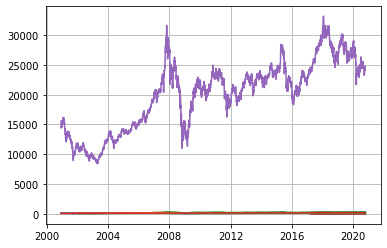

In [78]:
plt.plot(fund_df)
plt.grid()
plt.show()

In [6]:
# With normalisation
import copy
fund_normalised = copy.deepcopy(fund_df)
fund_normalised = (fund_normalised - fund_normalised.mean())/fund_normalised.std()
fund_normalised

,65歲後基金_Price,大中華股票基金_Price,中港動態資產配置基金_Price,中港基金_Price,日本股票基金_Price,北美股票基金_Price,全球基金_Price,均衡組合_Price,亞洲股票基金_Price,亞洲債券基金_Price,...,強積金保守基金_Price,富達增長基金_Price,富達穩定資本基金_Price,富達穩定增長基金_Price,綠色退休基金_Price,增長組合_Price,歐洲股票基金_Price,環球債券基金_Price,穩定資本組合_Price,HSI Close
Date,,,,,,,,,,,,,,,,,,,,,
2000-12-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.558336,NaN,NaN,...,-2.216500,NaN,NaN,NaN,NaN,-1.311079,NaN,NaN,-1.771319,-0.967804
2000-12-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.558336,NaN,NaN,...,-2.216500,NaN,NaN,NaN,NaN,-1.311079,NaN,NaN,-1.771319,-0.967804
2000-12-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.558336,NaN,NaN,...,-2.216500,NaN,NaN,NaN,NaN,-1.311079,NaN,NaN,-1.771319,-0.967804
2000-12-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.561244,NaN,NaN,...,-2.208845,NaN,NaN,NaN,NaN,-1.312965,NaN,NaN,-1.775039,-0.947449
2000-12-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.543534,NaN,NaN,...,-2.203742,NaN,NaN,NaN,NaN,-1.292224,NaN,NaN,-1.761510,-0.945036
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-10-18,2.200134,2.999021,1.390859,0.639297,1.780604,2.412067,1.635979,1.788824,1.839491,2.970245,...,1.411858,1.939778,2.443382,2.127156,2.163618,1.909382,0.936065,2.421389,1.714093,0.750498
2020-10-19,2.146929,2.997746,1.363980,0.672957,1.847956,2.332416,1.581499,1.787238,1.891617,2.990311,...,1.411858,1.938768,2.451891,2.132108,2.107595,1.903725,0.946203,2.456017,1.714093,0.777360
2020-10-20,2.129828,3.041331,1.480455,0.679348,1.816870,2.347844,1.618213,1.793581,1.892882,2.968015,...,1.411858,1.963001,2.461615,2.150502,2.124000,1.918055,0.945978,2.448026,1.717137,0.782073


In [7]:
# Function to perform an interactive data plotting using plotly express
# Plotly.express module which is imported as px includes functions that can plot interactive plots easily and effectively. 
# Every Plotly Express function uses graph objects internally and returns a plotly.graph_objects.Figure instance. 

def interactive_plot(df, title):
    fig = px.line(title = title)
    fig.update_yaxes( # the y-axis is in dollars
    tickprefix="HKD", showgrid=True)

  # Loop through each stock
    for i in df.columns:
        fig.add_scatter(x = df.index, y = df[i], name = i) # add a new Scatter trace

    fig.show()

In [8]:
interactive_plot(fund_df, "Fund Performance (without normalisation)")

In [9]:
interactive_plot(fund_normalised, "Fund Performance (with normalisation)")

In [11]:
fund_dayreturn = copy.deepcopy(fund_df)
fund_dayreturn = fund_dayreturn.diff()
fund_dayreturn = (fund_dayreturn.shift(-1) / fund_df)*100 
fund_dayreturn = fund_dayreturn.shift(1)
fund_dayreturn

,65歲後基金_Price,大中華股票基金_Price,中港動態資產配置基金_Price,中港基金_Price,日本股票基金_Price,北美股票基金_Price,全球基金_Price,均衡組合_Price,亞洲股票基金_Price,亞洲債券基金_Price,...,強積金保守基金_Price,富達增長基金_Price,富達穩定資本基金_Price,富達穩定增長基金_Price,綠色退休基金_Price,增長組合_Price,歐洲股票基金_Price,環球債券基金_Price,穩定資本組合_Price,HSI Close
Date,,,,,,,,,,,,,,,,,,,,,
2000-12-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2000-12-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,...,0.000000,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,0.000000,0.000000
2000-12-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,...,0.000000,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,0.000000,0.000000
2000-12-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.110000,NaN,NaN,...,0.030000,NaN,NaN,NaN,NaN,-0.100000,NaN,NaN,-0.110000,0.815778
2000-12-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.670738,NaN,NaN,...,0.019994,NaN,NaN,NaN,NaN,1.101101,NaN,NaN,0.400440,0.095953
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-10-18,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2020-10-19,-0.236786,-0.016767,-0.079540,0.504889,1.063069,-1.628043,-0.939670,-0.026475,0.794385,0.075295,...,0.000000,-0.012532,0.053208,0.047062,-0.940064,-0.110783,0.210645,0.193669,0.000000,0.637517
2020-10-20,-0.076291,0.573537,0.344950,0.095383,-0.485486,0.320561,0.639263,0.105928,0.019129,-0.083598,...,0.000000,0.300808,0.060776,0.174719,0.277880,0.280961,-0.004671,-0.044606,0.044324,0.111155


In [13]:
fund_yearreturn = copy.deepcopy(fund_df)
fund_yearreturn = fund_yearreturn.diff(360)
fund_yearreturn = (fund_yearreturn.shift(-360) / fund_df)*100 
fund_yearreturn = fund_yearreturn.shift(360)
fund_yearreturn

,65歲後基金_Price,大中華股票基金_Price,中港動態資產配置基金_Price,中港基金_Price,日本股票基金_Price,北美股票基金_Price,全球基金_Price,均衡組合_Price,亞洲股票基金_Price,亞洲債券基金_Price,...,強積金保守基金_Price,富達增長基金_Price,富達穩定資本基金_Price,富達穩定增長基金_Price,綠色退休基金_Price,增長組合_Price,歐洲股票基金_Price,環球債券基金_Price,穩定資本組合_Price,HSI Close
Date,,,,,,,,,,,,,,,,,,,,,
2000-12-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2000-12-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2000-12-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2000-12-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2000-12-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-10-18,6.445225,32.498001,5.021348,-6.046595,11.164138,13.903855,0.417094,6.549130,9.686152,5.229334,...,0.705343,9.330684,7.037670,8.158813,9.765692,8.698270,-4.296210,7.477384,5.656156,-8.997554
2020-10-19,6.298432,32.664412,5.015790,-5.515501,12.046691,11.425842,-0.905933,6.566013,10.454699,5.225194,...,0.660968,9.010794,7.103336,8.138943,8.455590,8.529931,-4.073128,7.944788,5.738687,-7.969021
2020-10-20,6.217336,33.425291,5.378042,-5.425379,11.502720,11.783029,-0.272461,6.678896,10.475828,5.137227,...,0.660968,9.338707,7.168430,8.327883,8.756966,8.834858,-4.077609,7.896638,5.785554,-7.866724


In [10]:
#Create a monthly dataframe for HSI index
import copy
hsi_df = fund_df.asfreq(freq='M').iloc[:, -1]
his_return = copy.deepcopy(hsi_df)
temp_df = his_return.diff()
his_return = (temp_df.shift(-1) / his_return) 
his_return = his_return.shift(1)
his_return.dropna(inplace = True)
hsi_monthly_df = pd.concat([hsi_df, his_return], axis=1)
hsi_monthly_df.dropna(inplace = True)
hsi_monthly_df.columns = ['HSI Close','HSI Return']
hsi_monthly_df

,HSI Close,HSI Return
Date,,
2001-01-31,16102.35,0.066697
2001-02-28,14787.87,-0.081633
2001-03-31,12760.64,-0.137087
2001-04-30,13386.04,0.049010
2001-05-31,13174.41,-0.015810
...,...,...
2020-05-31,22961.47,-0.068258
2020-06-30,24427.19,0.063834
2020-07-31,24595.35,0.006884


In [11]:
# Get Monthly return
fund_monthreturn = copy.deepcopy(fund_df)
fund_monthreturn = fund_monthreturn.asfreq(freq='M')
temp_df = fund_monthreturn.diff()
fund_monthreturn = (temp_df.shift(-1) / fund_monthreturn) 
fund_monthreturn = fund_monthreturn.shift(1)
fund_monthreturn.columns = [x.split("_")[0]+"_return" for x in fund_df.columns]
fund_monthreturn = fund_monthreturn[1:].drop('HSI Close_return', axis = 1)
fund_monthreturn

,65歲後基金_return,大中華股票基金_return,中港動態資產配置基金_return,中港基金_return,日本股票基金_return,北美股票基金_return,全球基金_return,均衡組合_return,亞洲股票基金_return,亞洲債券基金_return,...,基金經理精選退休基金_return,強積金保守基金_return,富達增長基金_return,富達穩定資本基金_return,富達穩定增長基金_return,綠色退休基金_return,增長組合_return,歐洲股票基金_return,環球債券基金_return,穩定資本組合_return
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.024071,NaN,NaN,...,NaN,0.003386,NaN,NaN,NaN,NaN,0.038977,NaN,NaN,0.015892
2001-02-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.029213,NaN,NaN,...,NaN,0.002878,NaN,NaN,NaN,NaN,-0.050500,NaN,NaN,-0.016518
2001-03-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.045835,NaN,NaN,...,NaN,0.003365,NaN,NaN,NaN,NaN,-0.065951,NaN,NaN,-0.033393
2001-04-30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.042293,NaN,NaN,...,NaN,0.002466,NaN,NaN,NaN,NaN,0.072126,NaN,NaN,0.025348
2001-05-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.011722,NaN,NaN,...,NaN,0.002066,NaN,NaN,NaN,NaN,-0.015984,NaN,NaN,-0.009370
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-05-31,0.008490,0.017084,-0.032975,-0.059278,0.074716,0.035759,0.034278,0.015933,0.040366,0.007462,...,0.017990,0.000088,0.013006,0.008395,0.009704,0.048688,0.022336,0.037538,0.014977,0.012467
2020-06-30,0.009208,0.102765,0.049663,0.064461,0.008747,0.020715,0.026575,0.032144,0.073758,0.017602,...,0.038605,0.000438,0.049562,0.020530,0.030154,0.024954,0.050537,0.047284,0.016255,0.023253
2020-07-31,0.017032,0.089752,0.027481,0.019819,0.000737,0.050223,0.050658,0.036412,0.095747,0.019610,...,0.040254,0.000088,0.047700,0.032314,0.039313,0.042420,0.044524,0.039574,0.042395,0.031505


In [12]:
# Get month prices
fund_month_df = copy.deepcopy(fund_df)
fund_month_df = fund_month_df.asfreq(freq='M')
fund_month_df = fund_month_df[1:].drop('HSI Close', axis = 1)
month_df = pd.concat([fund_month_df, fund_monthreturn], axis=1)
month_df

,65歲後基金_Price,大中華股票基金_Price,中港動態資產配置基金_Price,中港基金_Price,日本股票基金_Price,北美股票基金_Price,全球基金_Price,均衡組合_Price,亞洲股票基金_Price,亞洲債券基金_Price,...,基金經理精選退休基金_return,強積金保守基金_return,富達增長基金_return,富達穩定資本基金_return,富達穩定增長基金_return,綠色退休基金_return,增長組合_return,歐洲股票基金_return,環球債券基金_return,穩定資本組合_return
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,103.38,NaN,NaN,...,NaN,0.003386,NaN,NaN,NaN,NaN,0.038977,NaN,NaN,0.015892
2001-02-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100.36,NaN,NaN,...,NaN,0.002878,NaN,NaN,NaN,NaN,-0.050500,NaN,NaN,-0.016518
2001-03-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,95.76,NaN,NaN,...,NaN,0.003365,NaN,NaN,NaN,NaN,-0.065951,NaN,NaN,-0.033393
2001-04-30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,99.81,NaN,NaN,...,NaN,0.002466,NaN,NaN,NaN,NaN,0.072126,NaN,NaN,0.025348
2001-05-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,98.64,NaN,NaN,...,NaN,0.002066,NaN,NaN,NaN,NaN,-0.015984,NaN,NaN,-0.009370
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-05-31,1.1403,232.18,100.88,145.05,174.91,238.96,130.95,205.95,208.25,114.76,...,0.017990,0.000088,0.013006,0.008395,0.009704,0.048688,0.022336,0.037538,0.014977,0.012467
2020-06-30,1.1508,256.04,105.89,154.40,176.44,243.91,134.43,212.57,223.61,116.78,...,0.038605,0.000438,0.049562,0.020530,0.030154,0.024954,0.050537,0.047284,0.016255,0.023253
2020-07-31,1.1704,279.02,108.80,157.46,176.57,256.16,141.24,220.31,245.02,119.07,...,0.040254,0.000088,0.047700,0.032314,0.039313,0.042420,0.044524,0.039574,0.042395,0.031505


fund_yearreturn = fund_yearreturn.drop('HSI Close', axis = 1).dropna(thresh=12)
fund_yearreturn

In [989]:
def polt_multihist(df, size):  
    plt.figure(1,figsize=(80,80))

    for i in range(len(df.columns)):
        plt.subplot(6,4,1+i)
        plt.hist(df[df.columns[i]], 40)
        plt.title(df.columns[i],fontsize=20)
        plt.plot([0,0],[0,size],linewidth=5)
    #     plt.hist(fund_df.index, fund_df[fund_df.columns[i]])
    #     plt.ylim(0, df[df.columns[i]].max())

    plt.show()

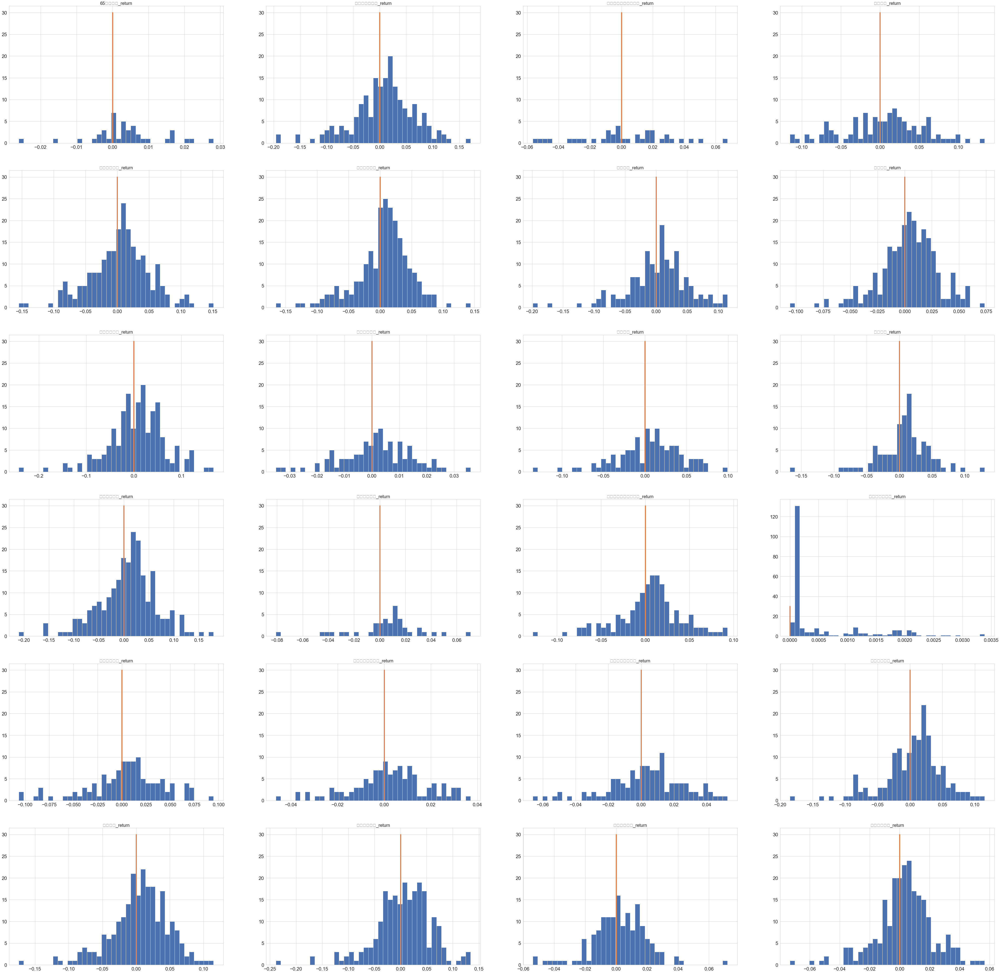

In [990]:
polt_multihist(fund_monthreturn,30)

In [36]:
fund_quarterreturn = fund_quarterreturn.drop('HSI Close', axis = 1)
fund_quarterreturn

,65歲後基金_Price,大中華股票基金_Price,中港動態資產配置基金_Price,中港基金_Price,日本股票基金_Price,北美股票基金_Price,全球基金_Price,均衡組合_Price,亞洲股票基金_Price,亞洲債券基金_Price,...,基金經理精選退休基金_Price,強積金保守基金_Price,富達增長基金_Price,富達穩定資本基金_Price,富達穩定增長基金_Price,綠色退休基金_Price,增長組合_Price,歐洲股票基金_Price,環球債券基金_Price,穩定資本組合_Price
Date,,,,,,,,,,,,,,,,,,,,,
2000-12-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2001-03-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.051412,NaN,NaN,...,NaN,0.009660,NaN,NaN,NaN,NaN,-0.078553,NaN,NaN,-0.034251
2001-06-30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.019528,NaN,NaN,...,NaN,0.006510,NaN,NaN,NaN,NaN,0.038178,NaN,NaN,0.008585
2001-09-30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.047731,NaN,NaN,...,NaN,0.004312,NaN,NaN,NaN,NaN,-0.115963,NaN,NaN,-0.007296
2001-12-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.035280,NaN,NaN,...,NaN,0.000976,NaN,NaN,NaN,NaN,0.079414,NaN,NaN,0.010821
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-09-30,0.023718,-0.010017,-0.029527,-0.071747,0.026465,0.002193,-0.006533,-0.011108,-0.019237,0.007900,...,-0.020061,0.002830,-0.017157,-0.000164,-0.005772,0.017807,-0.023514,-0.042348,0.003225,-0.003863
2019-12-31,0.002335,0.125531,0.049300,0.085429,0.078399,0.072180,0.075976,0.041504,0.088113,0.002202,...,0.064629,0.002910,0.078905,0.021688,0.040053,0.083295,0.073143,0.070039,0.000482,0.022642
2020-03-31,-0.014693,-0.122860,-0.092715,-0.159625,-0.176070,-0.208126,-0.261769,-0.116397,-0.277060,-0.021617,...,-0.160875,0.002901,-0.170992,-0.047501,-0.088680,-0.222139,-0.187452,-0.267679,-0.023454,-0.074774


# Assets Allocation

In [571]:
# Functions for calculating Calmar Ratio
def cumulative_returns(df_returns):
#     df -> float
    res = (df_returns + 1.0).prod()
    return res

def max_drawdown(df_returns):
    #     df -> float
    cum_returns = (df_returns + 1.0).cumprod()
    max_returns = np.fmax.accumulate(cum_returns)
    res = (cum_returns / max_returns) - 1
    res = abs(res).max()
    return res

def Generate_weightings(selected_df):
#     df -> array
    portfolio_weightings = []
    # Iterate over column names 
    for column in selected_df: 
        # Select column contents by column 
        # name using [] operator 
        columnSeriesObj = selected_df[column]
        if columnSeriesObj.isna().all():
            weight = 0
        else:
            weight = np.random.random_sample()
        portfolio_weightings.append(weight)
    #below line ensures that the sum of our weights is 1
    sum_of_weightings = sum(portfolio_weightings)
    portfolio_weightings = [x/sum_of_weightings for x in portfolio_weightings]
#         weight redistribution implement: for weights < 0.02 -> redistribute it to the largest weight element
    ind = np.argmax(portfolio_weightings)
    residual_weights = 0
    for i, weight in enumerate(portfolio_weightings):
        if weight < 0.02:
            residual_weights += weight
            portfolio_weightings[i] = 0
    portfolio_weightings[ind] += residual_weights
    return np.array(portfolio_weightings)

In [689]:
def portfolios(selected_df):
#     df -> df
    
    number_of_portfolios = 500
#     RF = 0.02  #According to the newest minimun ibond rate

    portfolio_returns = []
#     portfolio_risk = []
#     sharpe_ratio_port = []
#     calmar_ratio_port = []
    portfolio_weights = []
#     max_dd_df = max_drawdown(selected_df)
    
#     no_of_fund = len(selected_df.columns)
#     no_of_ava_fund = len(selected_df.dropna(axis='columns').columns)
    for portfolio in range (number_of_portfolios):
        weights = Generate_weightings(selected_df)
        portfolio_weights.append(weights)
        
        period_return = np.sum(selected_df.mean() * weights)
        portfolio_returns.append(period_return)
        
    score_weights = lgb_model.predict(portfolio_weights)
    for real,pred in zip(weights,score_weights):
        new_weights = [real for real,pred in zip(weights,score_weights) if (pred != 0)]

    porfolio_metrics = np.array([portfolio_returns,portfolio_weights])
#     #from Python list we create a Pandas DataFrame
#     portfolio_dfs = pd.DataFrame(porfolio_metrics)
#     portfolio_dfs = portfolio_dfs.T
#     portfolio_dfs.columns = ['Portfolio Returns','Portfolio Weights']
    
#     #convert from object to float for columns.
#     portfolio_dfs[portfolio_dfs.columns[:-1]] = portfolio_dfs[portfolio_dfs.columns[:-1]].astype('float')
    
    return porfolio_metrics # np.array
'''
        #std
        matrix_covariance_portfolio = (selected_df.cov())
        matrix_covariance_portfolio.fillna(0,inplace=True)
        portfolio_variance = np.dot(weights.T,np.dot(matrix_covariance_portfolio, weights))
        portfolio_standard_deviation= np.sqrt(portfolio_variance) 
        portfolio_risk.append(portfolio_standard_deviation)

        #sharpe_ratio
        sharpe_ratio = ((period_return- RF)/portfolio_standard_deviation)
        sharpe_ratio_port.append(sharpe_ratio)

        #Calmar_ratio
        max_dd = np.sum(max_dd_df * weights)
        if max_dd > 0:
            calmar_ratio = period_return / max_dd
        else:
            calmar_ratio = np.nan
        calmar_ratio_port.append(calmar_ratio) 

        
        
    porfolio_metrics = [portfolio_returns,portfolio_risk,sharpe_ratio_port,calmar_ratio_port, portfolio_weights] 
    #from Python list we create a Pandas DataFrame
    portfolio_dfs = pd.DataFrame(porfolio_metrics)
    portfolio_dfs = portfolio_dfs.T
    portfolio_dfs.columns = ['Portfolio Returns','Portfolio Risk','Sharpe Ratio','Calmar Ratio','Portfolio Weights']
    
    #convert from object to float for columns.
#     for col in portfolio_dfs.columns[:-1]:
#         portfolio_dfs[col] = portfolio_dfs[col].astype(float)
#     portfolio_dfs
    portfolio_dfs[portfolio_dfs.columns[:-1]] = portfolio_dfs[portfolio_dfs.columns[:-1]].astype('float')
'''

"\n        #std\n        matrix_covariance_portfolio = (selected_df.cov())\n        matrix_covariance_portfolio.fillna(0,inplace=True)\n        portfolio_variance = np.dot(weights.T,np.dot(matrix_covariance_portfolio, weights))\n        portfolio_standard_deviation= np.sqrt(portfolio_variance) \n        portfolio_risk.append(portfolio_standard_deviation)\n\n        #sharpe_ratio\n        sharpe_ratio = ((period_return- RF)/portfolio_standard_deviation)\n        sharpe_ratio_port.append(sharpe_ratio)\n\n        #Calmar_ratio\n        max_dd = np.sum(max_dd_df * weights)\n        if max_dd > 0:\n            calmar_ratio = period_return / max_dd\n        else:\n            calmar_ratio = np.nan\n        calmar_ratio_port.append(calmar_ratio) \n\n        \n        \n    porfolio_metrics = [portfolio_returns,portfolio_risk,sharpe_ratio_port,calmar_ratio_port, portfolio_weights] \n    #from Python list we create a Pandas DataFrame\n    portfolio_dfs = pd.DataFrame(porfolio_metrics)\n    port

In [999]:
def portfolio_weights_gen(selected_df):
#     df -> weight list, risk list
    number_of_portfolios = 50
    portfolio_returns = []
    portfolio_weights = []
    portfolio_risk = []
    for portfolio in range (number_of_portfolios):
        weights = Generate_weightings(selected_df)
        portfolio_weights.append(weights)
        
        #return 
        period_return = np.sum(selected_df.mean() * weights)
        portfolio_returns.append(period_return)
        
        #std
        matrix_covariance_portfolio = (selected_df.cov())
        matrix_covariance_portfolio.fillna(0,inplace=True)
        portfolio_variance = np.dot(weights.T,np.dot(matrix_covariance_portfolio, weights))
        portfolio_standard_deviation= np.sqrt(portfolio_variance) 
        portfolio_risk.append(portfolio_standard_deviation)
        
    return portfolio_weights, portfolio_risk, period_return

In [692]:
def select_by_sharpratio(portfolio_dfs):
#     df -> series of weights
    return portfolio_dfs.iloc[portfolio_dfs['Sharpe Ratio'].idxmax()]['Portfolio Weights']
    
def select_by_calmar_ratio(portfolio_dfs):
#     df -> series of weights
    return portfolio_dfs.iloc[portfolio_dfs['Sharpe Ratio'].idxmax()]['Portfolio Weights']
    
def select_by_leastrisk(portfolio_dfs):
#     df -> series of weights
    return portfolio_dfs.iloc[portfolio_dfs['Portfolio Risk'].idxmin()]['Portfolio Weights']
    
def select_by_maxreturn(portfolio_dfs):
#     df -> series of weights
    return portfolio_dfs.iloc[portfolio_dfs['Portfolio Returns'].idxmax()]['Portfolio Weights']

def select_maxreturn(porfolio_metrics):
#     np.array -> np.array(weights)
    max_return_index = np.argmax(porfolio_metrics[0])
    weightings = porfolio_metrics[1][max_return_index]
    return weightings

In [375]:
#Reform month_df
month_df = pd.concat([fund_month_df, fund_monthreturn], axis=1)
# Rename month_df
rename_col = [col.replace("return","Return") for col in month_df.columns]
month_df.columns = rename_col
month_df.head()

,65歲後基金_Price,大中華股票基金_Price,中港動態資產配置基金_Price,中港基金_Price,日本股票基金_Price,北美股票基金_Price,全球基金_Price,均衡組合_Price,亞洲股票基金_Price,亞洲債券基金_Price,...,基金經理精選退休基金_Return,強積金保守基金_Return,富達增長基金_Return,富達穩定資本基金_Return,富達穩定增長基金_Return,綠色退休基金_Return,增長組合_Return,歐洲股票基金_Return,環球債券基金_Return,穩定資本組合_Return
Date,,,,,,,,,,,,,,,,,,,,,
2001-01-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,103.38,NaN,NaN,...,NaN,0.003386,NaN,NaN,NaN,NaN,0.038977,NaN,NaN,0.015892
2001-02-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100.36,NaN,NaN,...,NaN,0.002878,NaN,NaN,NaN,NaN,-0.050500,NaN,NaN,-0.016518
2001-03-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,95.76,NaN,NaN,...,NaN,0.003365,NaN,NaN,NaN,NaN,-0.065951,NaN,NaN,-0.033393
2001-04-30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,99.81,NaN,NaN,...,NaN,0.002466,NaN,NaN,NaN,NaN,0.072126,NaN,NaN,0.025348
2001-05-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,98.64,NaN,NaN,...,NaN,0.002066,NaN,NaN,NaN,NaN,-0.015984,NaN,NaN,-0.009370


In [593]:
a = [1,2,3]
b = [4,5,6]
np.vstack([a, b])

array([[1, 2, 3],
       [4, 5, 6]])

In [950]:
# Create a function that takes in the stock prices along with the weights and retun:
# (1) Period value of each individual securuty in $ over the specified time period

def portfolio_value(row, weights):
#     row,weight_list -> float
    asset_value = 0
    asset_value = np.nansum(row*weights)
    return asset_value

In [1014]:
# # Initial weight_list and label_list
weights_list = []
label_list = []

# Seperate the dataframe into model dataset and validation dataset
model_df = month_df[:-24]
validation_df = month_df[-48:]
model_hsi_df = hsi_monthly_df[:-24]
validation_hsi_df = hsi_monthly_df[-48:]

In [992]:
validation_df

,65歲後基金_Price,大中華股票基金_Price,中港動態資產配置基金_Price,中港基金_Price,日本股票基金_Price,北美股票基金_Price,全球基金_Price,均衡組合_Price,亞洲股票基金_Price,亞洲債券基金_Price,...,基金經理精選退休基金_Return,強積金保守基金_Return,富達增長基金_Return,富達穩定資本基金_Return,富達穩定增長基金_Return,綠色退休基金_Return,增長組合_Return,歐洲股票基金_Return,環球債券基金_Return,穩定資本組合_Return
Date,,,,,,,,,,,,,,,,,,,,,
2016-10-31,NaN,177.88,NaN,134.55,153.38,176.58,113.75,187.57,194.16,105.93,...,-0.011354,0.000090,-0.019174,-0.022491,-0.022486,-0.023890,-0.014830,-0.028797,-0.021663,-0.014242
2016-11-30,NaN,176.47,NaN,134.83,146.33,184.69,112.53,184.97,189.09,102.43,...,-0.007767,0.000090,-0.006744,-0.020371,-0.016807,0.011407,-0.002270,-0.019713,-0.031889,-0.017178
2016-12-31,NaN,170.29,NaN,129.29,144.91,187.70,113.99,184.19,190.04,100.89,...,-0.006690,0.000090,-0.002922,-0.002228,-0.001986,0.025021,-0.006183,0.043432,0.001501,-0.004167
2017-01-31,NaN,180.87,NaN,137.24,150.88,192.09,119.42,188.37,202.17,102.51,...,0.035630,0.000090,0.040428,0.013026,0.022145,0.023681,0.043900,0.037483,-0.005908,0.013192
2017-02-28,NaN,185.48,NaN,140.75,152.67,197.36,121.82,191.38,206.98,103.94,...,0.018535,0.000090,0.017316,0.010929,0.013626,0.021639,0.015925,-0.003736,0.014635,0.014053
2017-03-31,NaN,187.81,NaN,142.45,153.67,198.89,123.31,193.08,213.93,104.26,...,0.012515,0.000090,0.016288,0.006723,0.010353,0.011914,0.019665,0.037549,0.002360,0.005260
2017-04-30,1.0061,192.61,NaN,144.61,156.22,200.95,124.58,195.66,216.84,104.39,...,0.016081,0.000090,0.016187,0.011642,0.013387,0.017695,0.023796,0.047428,0.014042,0.010353
2017-05-31,1.0125,197.74,NaN,151.14,163.91,202.80,125.87,198.95,220.12,105.81,...,0.020606,0.000090,0.031464,0.018555,0.023567,0.027400,0.028144,0.038002,0.013245,0.013088
2017-06-30,1.0094,202.24,NaN,151.94,164.69,203.96,126.41,199.99,225.28,106.03,...,0.008818,0.000090,0.005963,0.002452,0.003904,0.003095,0.008833,-0.007650,-0.000255,0.002529


In [1015]:
#Generate training data

# model_df['portfolio worth in HKD'] = 0
# model_df['portfolio period % return'] = 0.00

train_period = 24
for i in range(len(model_df)-(train_period+1)):
#     print("i= {} i+35= {}".format(i,(i+train_period)))
    train_df = model_df.filter(regex='Return')[i:i+train_period]
    reference_df = model_hsi_df.filter(regex='Return')[i:i+train_period]
#     portfolio_dfs = portfolios(train_df,reference_df)
    weights, std, period_return = portfolio_weights_gen(train_df)
#     if i != (len(model_df)-train_period):
    weights_list.append(weights)
    allocate_df = model_df.filter(regex='[Po]')
    for i in range(len(weights)):
        old_asset_value = portfolio_value(allocate_df.iloc[i+train_period],weights[i])
        new_asset_value = portfolio_value(allocate_df.iloc[i+train_period+1],weights[i])
        
        # Calculate the percentage of change from the previous month
#         model_df['portfolio period % return'][i+train_period] = \
        monthly_return_of_portfolio = (new_asset_value - old_asset_value)/old_asset_value
        if (period_return >= (reference_df.mean().values)) and (std[i] < reference_df.std().values) and (monthly_return_of_portfolio>=(reference_df.mean().values + 0.04)):
            label_of_portfolio = 2
        elif (monthly_return_of_portfolio >= (reference_df.mean().values)) and (std[i] < reference_df.std().values):
            label_of_portfolio = 1
        else:
            label_of_portfolio = 0
        label_list.append(label_of_portfolio)

In [1008]:
# Chech the length of label_list
len(label_list)

9400

In [1009]:
np.array(weights_list).shape

(188, 50, 24)

In [1010]:
# Change list into desired shape
weights_list = np.reshape(np.array(weights_list),(9400,24))
# weights_list
weights_list.shape

(9400, 24)

In [1012]:
from collections import Counter
counter = Counter(label_list)
for k,v in counter.items():
    per = v / len(label_list) * 100
    print('Class=%s, Count=%d, Percentage=%.3f%%' % (k, v, per))

Class=1, Count=4347, Percentage=46.245%
Class=0, Count=5053, Percentage=53.755%


In [547]:
# Save the result to csv file for future access
with open(r'C:\Users\wmkoa\Downloads\Fund data\modeling_data.csv', 'w') as f:
    np.savetxt(f, (np.column_stack([weights_list,label_list])))

In [548]:
# Read csv file to get the training data
with open(r'C:\Users\wmkoa\Downloads\Fund data\modeling_data.csv', 'r') as f:
    data = np.loadtxt(f, dtype='str')
temp_ar = [] # weights
label_ar = [] # label
for i in range(len(data)):
    temp_ = data[i].astype('float')
    temp_ar.append([x for x in temp_[:-1]])
    label_ar.append(int(temp_[-1]))

# Prepare Test Dataset

In [549]:
# Set train_data and target
X = weights_list
y = label_list

# Split dataset
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0, stratify=y)

#Featuen Scaling
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
x_train = sc.fit_transform(x_train)
x_test = sc.fit_transform(x_test)

# Reference: Dummy Model

In [550]:
from sklearn.dummy import DummyClassifier
strategy = ['uniform','most_frequent','prior']
for str_item in strategy:
    # define the reference model
    model = DummyClassifier(strategy=str_item)
    # evaluate the model
    gkf = KFold(n_splits=5, shuffle=True, random_state=42).split(x_train, y_train)
    scores = cross_val_score(model, x_train, y_train, scoring='accuracy', cv=gkf, n_jobs=-1)
    # summarize performance
    print('Mean Accuracy: %.3f (%.3f)' % (scores.mean(), scores.std()))

Mean Accuracy: 0.327 (0.016)
Mean Accuracy: 0.511 (0.015)
Mean Accuracy: 0.511 (0.015)


# Building model - LightGBM 

In [36]:
categoricals = [ i.split('_')[0] for i in month_df.columns if 'Price' in i]

In [570]:
#Model building
import lightgbm as lgb
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import KFold

# d_train = lgb.Dataset(x_train,categorical_feature=categoricals, label=y_train)
# Train with 5-fold CV:
# lgb.cv(params, d_train, num_round, nfold = 10)

gkf = KFold(n_splits=5, shuffle=True, random_state=42).split(x_train, y_train)

param_grid = {
#     'learning_rate' : [round(x,2) for x in np.random.uniform(0, 1, 10)],
    'learning_rate' : [0.01,0.05,0.1,0.3,0.6],
    'max_depth' : np.random.randint(5, 20,5),
    'feature_fraction' : [0.5,0.7,0.8,0.9],
#     'cat_smooth' : [1,10,15],
    'num_leaves': np.random.randint(10, 50,5),
#     'min_data_in_leaf': np.random.randint(5, 20,5),
#     'lambda_l1': [round(x,2) for x in np.random.uniform(0, 1, 3)],
#     'lambda_l2': np.random.randint(0, 50 ,3),
    'boosting_type' : ['gbdt','rf','dart']
    }

lgb_estimator = lgb.LGBMClassifier(objective='binary', num_boost_round=100, metric='binary_logloss',num_class=3)
gsearch = GridSearchCV(estimator=lgb_estimator, param_grid=param_grid, cv=gkf)
lgb_model = gsearch.fit(x_train, y_train)

# Best Score
print("Best score: %0.3f" % lgb_model.best_score_)
print("Best parameters set:")

# Best params
best_parameters = lgb_model.best_estimator_.get_params()
for param_name in sorted(best_parameters.keys()):
    print("\t%s: %r" % (param_name, best_parameters[param_name]))

# Save to file in the current working directory
# joblib_file = "lgb_model.pkl"
# joblib.dump(clf, joblib_file)

KeyboardInterrupt: 

In [556]:
# Prediction
y_pred=lgb_model.predict(x_test)

#convert into binary values
for i in range(len(y_pred)):
    if y_pred[i] >= 0.5:
        y_pred[i] = 1
    else:
        y_pred[i] = 0

In [347]:
[x for x in y_pred if (x==0)]

[]

In [557]:
#Confusion matrix
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test, y_pred)

#Accuracy
from sklearn.metrics import accuracy_score
accuracy = accuracy_score(y_test, y_pred)

In [558]:
cm

array([[139, 547,   0],
       [126, 839,   0],
       [ 19, 220,   0]], dtype=int64)

In [559]:
accuracy

0.5174603174603175

In [560]:
y_pred=lgb_model.predict([weights_list[10]])
y_pred

array([1])

In [524]:
label_list[10]

1

# Display the importance of features

In [527]:
lgb_model.best_estimator_.feature_importances_

array([ 1, 34,  6, 12, 32, 36, 34, 35, 29,  9, 21, 15, 37, 12, 28, 46, 10,
       21, 10, 16, 29, 34, 19, 34])

,Features,Importance
0,大中華股票基金,462
1,亞洲股票基金,395
2,香港股票基金,385
3,基金經理精選退休基金,375
4,綠色退休基金,343
5,強積金保守基金,336
6,日本股票基金,310
7,增長組合,306
8,歐洲股票基金,301
9,穩定資本組合,281


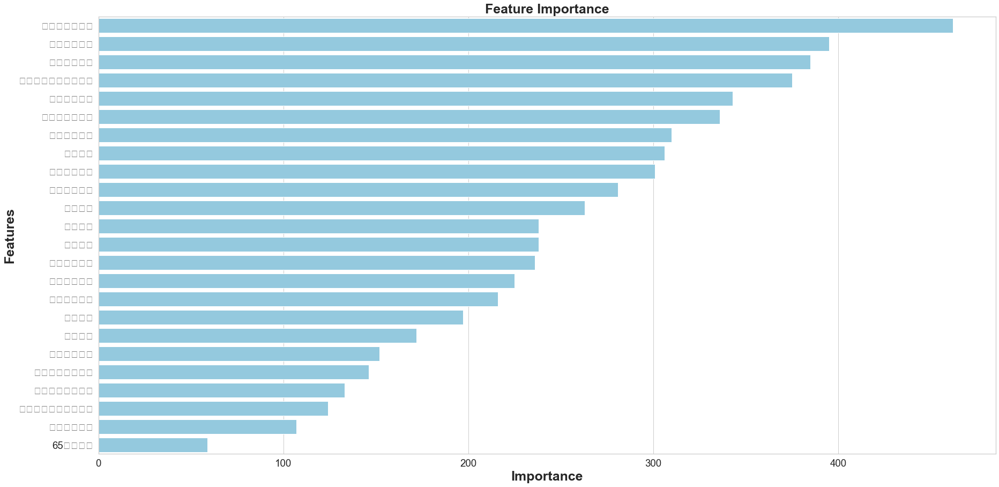

In [562]:
feats = {}
feature_names = [x.split('_')[0] for x in model_df.filter(regex='[Po]').columns]
for feature, importance in zip(feature_names, lgb_model.best_estimator_.feature_importances_):
    feats[feature] = importance
importances = pd.DataFrame.from_dict(feats, orient='index').rename(columns={0: 'Importance'})
importances = importances.sort_values(by='Importance', ascending=False)
importances = importances.reset_index()
importances = importances.rename(columns={'index': 'Features'})

sns.set(style="whitegrid", color_codes=True, font_scale = 1.7)
fig, ax = plt.subplots()
fig.set_size_inches(30,15)
sns.barplot(x=importances['Importance'], y=importances['Features'], data=importances, color='skyblue')
plt.xlabel('Importance', fontsize=25, weight = 'bold')
plt.ylabel('Features', fontsize=25, weight = 'bold')
plt.title('Feature Importance', fontsize=25, weight = 'bold')
display(importances)

# Backtestng

In [575]:
# Method distribute captial
def capital_allocation(row,cash_limit):
#     row -> list(fund unit), remaining balance
    fund_purchase_unit = []
    remaining_balance = 0
    for cash,val in zip(cash_limit,row):
        if not np.isnan(val):
            unit = cash // val
            fund_purchase_unit.append(unit)
            remaining_balance += cash - (val * unit)
    return fund_purchase_unit,remaining_balance

In [862]:
# validation_df
train_period = 24
available_capital = 0
remaining_balance = 0

# Initiate the allocate_df
fund_unit_list = pd.DataFrame([])
allocate_df = validation_df.filter(regex='[Po]')
validation_price_graph = validation_df.filter(regex='[Po]')
validation_price_graph['Unit value'] = 0.00
validation_price_graph['Unit monthly return'] = 0.00
validation_price_graph['Portfolio value'] = 0.00
validation_price_graph['Portfolio monthly return'] = 0.00

for i in range(len(validation_df)-(train_period+1)):
    available_capital += 2000 + remaining_balance
    remaining_balance = 0
    train_df = validation_df.filter(regex='Return')[i:i+train_period]
    
    # Genarate weights and portfolio information
    portfolio_metrix = portfolios(train_df)
    
    # select a array of weights based on return maximisation
    selected_weight = select_maxreturn(portfolio_metrix)
    
    # store the unit value for graph
    old_unit_value = np.nansum(allocate_df.iloc[i+train_period] * selected_weight)
    new_unit_value = np.nansum(allocate_df.iloc[i+train_period+1] * selected_weight)
    validation_price_graph['Unit value'][i+train_period] = np.nansum(allocate_df.iloc[i+train_period] * selected_weight)
    validation_price_graph['Unit monthly return'][i+train_period+1] = (new_unit_value - old_unit_value)/old_unit_value
    
    # Capital allocation
    cash_for_buy = available_capital * selected_weight
    fund_purchase_unit, remaining_balance = capital_allocation(allocate_df.iloc[i+train_period],cash_for_buy)
    series_unit = pd.DataFrame([[fund_purchase_unit],[selected_weight]]).T
    fund_unit_list = pd.concat([fund_unit_list,series_unit],ignore_index = True)
    
    old_portfolio_value = np.nansum(allocate_df.iloc[i+train_period] * fund_purchase_unit)
    new_portfolio_value = np.nansum(allocate_df.iloc[i+train_period+1] * fund_purchase_unit)
    validation_price_graph['Portfolio value'][i+train_period] = old_portfolio_value
    # Calculate the percentage of change from the previous month
#         validation_df['portfolio period % return'][i+train_period] = \
    validation_price_graph['Portfolio monthly return'][i+train_period+1] = (new_asset_value - old_asset_value)/old_asset_value

In [865]:
fund_unit_list.head(1)

,Accummulated Fund Unit,Fund weights
Date,,
2018-10-31,"[84.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[0.04286317510959116, 0.0, 0.0, 0.0, 0.0797297..."


In [864]:
# Concat the fund unit df to the main one
useful_df = validation_price_graph[validation_price_graph['Unit value'] !=0]
fund_unit_list.index = useful_df.index
fund_unit_list.columns = ['Accummulated Fund Unit','Fund weights']
result_graph_df = pd.concat([validation_price_graph,fund_unit_list],axis=1)
result_graph_df

,65歲後基金_Price,大中華股票基金_Price,中港動態資產配置基金_Price,中港基金_Price,日本股票基金_Price,北美股票基金_Price,全球基金_Price,均衡組合_Price,亞洲股票基金_Price,亞洲債券基金_Price,...,增長組合_Price,歐洲股票基金_Price,環球債券基金_Price,穩定資本組合_Price,Unit value,Unit monthly return,Portfolio value,Portfolio monthly return,Accummulated Fund Unit,Fund weights
Date,,,,,,,,,,,,,,,,,,,,,
2016-10-31,NaN,177.88,NaN,134.55,153.38,176.58,113.75,187.57,194.16,105.93,...,202.62,184.14,116.97,175.81,0.000000,0.000000,0.0000,0.000000,NaN,NaN
2016-11-30,NaN,176.47,NaN,134.83,146.33,184.69,112.53,184.97,189.09,102.43,...,202.16,180.51,113.24,172.79,0.000000,0.000000,0.0000,0.000000,NaN,NaN
2016-12-31,NaN,170.29,NaN,129.29,144.91,187.70,113.99,184.19,190.04,100.89,...,200.91,188.35,113.41,172.07,0.000000,0.000000,0.0000,0.000000,NaN,NaN
2017-01-31,NaN,180.87,NaN,137.24,150.88,192.09,119.42,188.37,202.17,102.51,...,209.73,195.41,112.74,174.34,0.000000,0.000000,0.0000,0.000000,NaN,NaN
2017-02-28,NaN,185.48,NaN,140.75,152.67,197.36,121.82,191.38,206.98,103.94,...,213.07,194.68,114.39,176.79,0.000000,0.000000,0.0000,0.000000,NaN,NaN
2017-03-31,NaN,187.81,NaN,142.45,153.67,198.89,123.31,193.08,213.93,104.26,...,217.26,201.99,114.66,177.72,0.000000,0.000000,0.0000,0.000000,NaN,NaN
2017-04-30,1.0061,192.61,NaN,144.61,156.22,200.95,124.58,195.66,216.84,104.39,...,222.43,211.57,116.27,179.56,0.000000,0.000000,0.0000,0.000000,NaN,NaN
2017-05-31,1.0125,197.74,NaN,151.14,163.91,202.80,125.87,198.95,220.12,105.81,...,228.69,219.61,117.81,181.91,0.000000,0.000000,0.0000,0.000000,NaN,NaN
2017-06-30,1.0094,202.24,NaN,151.94,164.69,203.96,126.41,199.99,225.28,106.03,...,230.71,217.93,117.78,182.37,0.000000,0.000000,0.0000,0.000000,NaN,NaN


In [866]:
result_graph_df.dropna(inplace=True)

In [895]:
result_graph_df.head(5)

,65歲後基金_Price,大中華股票基金_Price,中港動態資產配置基金_Price,中港基金_Price,日本股票基金_Price,北美股票基金_Price,全球基金_Price,均衡組合_Price,亞洲股票基金_Price,亞洲債券基金_Price,...,增長組合_Price,歐洲股票基金_Price,環球債券基金_Price,穩定資本組合_Price,Unit value,Unit monthly return,Portfolio value,Portfolio monthly return,Accummulated Fund Unit,Fund weights
Date,,,,,,,,,,,,,,,,,,,,,
2018-10-31,1.0144,194.77,105.33,152.74,167.54,228.51,135.01,197.14,215.01,104.92,...,231.74,211.76,115.07,179.22,168.226235,0.000000,727.9689,0.000000,"[84.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[0.04286317510959116, 0.0, 0.0, 0.0, 0.0797297..."
2018-11-30,1.0208,202.61,107.24,161.82,167.51,229.49,135.43,199.16,219.97,106.59,...,235.77,205.84,114.85,180.33,162.751469,0.012923,3950.3804,0.013717,"[118.0, 1.0, 2.0, 2.0, 0.0, 1.0, 2.0, 0.0, 1.0...","[0.02288904328216935, 0.047193238600776025, 0...."
2018-12-31,1.0184,195.56,106.52,156.98,154.73,208.53,126.11,195.19,215.39,107.99,...,224.94,197.59,117.19,179.11,166.945071,-0.048673,7232.0684,0.013717,"[376.0, 1.0, 0.0, 3.0, 0.0, 6.0, 5.0, 3.0, 1.0...","[0.04456173040194172, 0.025811199145560997, 0...."
2019-01-31,1.0396,210.59,109.80,169.84,163.88,224.29,137.45,204.36,225.79,110.13,...,240.31,213.34,119.28,184.99,180.458632,0.069204,10681.1313,0.013717,"[0.0, 3.0, 0.0, 4.0, 0.0, 2.0, 0.0, 0.0, 2.0, ...","[0.0, 0.06215963257541906, 0.0, 0.066372693105..."
2019-02-28,1.0426,219.28,111.78,174.44,163.69,231.73,139.31,206.80,228.49,110.07,...,245.57,219.52,118.82,186.22,182.309753,0.021518,13282.6160,0.013717,"[660.0, 3.0, 0.0, 12.0, 4.0, 4.0, 2.0, 0.0, 3....","[0.04522517041440634, 0.04734052649604913, 0.0..."


In [840]:
# Define a function to extract list of unit for each fund
def Extract(lst,item_num): 
    return [item[item_num] for item in lst]

In [870]:
result_list = []
loop_array = result_graph_df['Fund weights'].values
for i in range(len(loop_array[0])):
    result_list.append(Extract(loop_array,i))

In [994]:
pd.DataFrame(feature_names)[::-1]

,0
23,穩定資本組合
22,環球債券基金
21,歐洲股票基金
20,增長組合
19,綠色退休基金
18,富達穩定增長基金
17,富達穩定資本基金
16,富達增長基金
15,強積金保守基金
14,基金經理精選退休基金


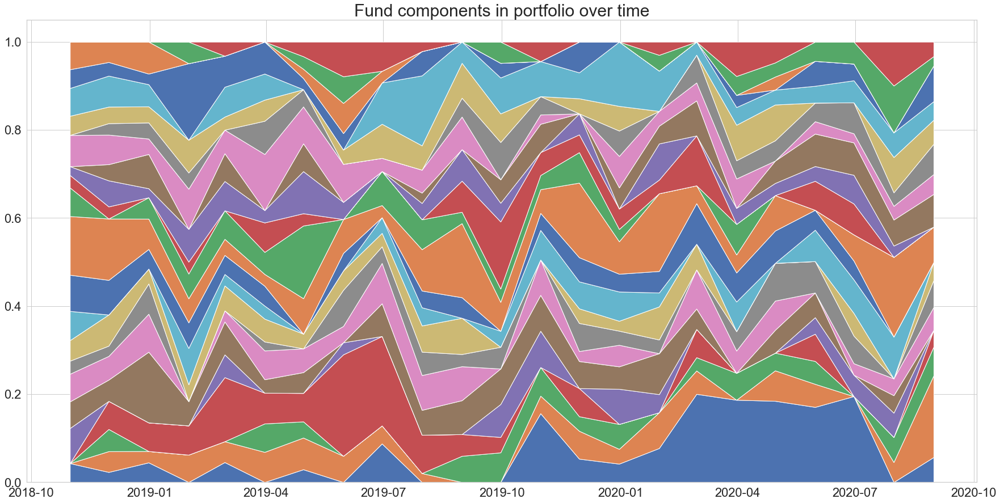

In [986]:
# Plot distrubution Graph - Stacked area chart
# Data
feature_names = [x.split('_')[0] for x in model_df.filter(regex='[Po]').columns]

x= result_graph_df.index
y= result_list
 
# Plot
sns.set(style="whitegrid", color_codes=True, font_scale = 2)
fig, ax = plt.subplots()
fig.set_size_inches(30,15)
plt.stackplot(x,y)
plt.title('Fund components in portfolio over time',fontsize=30)
# plt.legend(loc='upper left')
plt.show()

In [878]:
fig = px.line(title = 'Fund components in portfolio over time')
x= result_graph_df.index
y= result_list

# Add the first trace
# fig.add_trace(go.Scatter(x=x, y=y[0], fill='tozeroy'))
fig.update_yaxes(showgrid=True)
# Loop through each weight
for i in range(len(result_list)):
    fig.add_trace(go.Scatter(x=x, y=y[i], hoverinfo='x+y',
    mode='lines',
    name = feature_names[i],
    stackgroup='one')) # add a new trace
fig.show()

In [949]:
# Calculate the value of change using the return of HSI of the same period
calculate_arr = (validation_hsi_df.filter(regex='Return')[-24:]+1).values
estimated_balace = []
balance = 0
for return_item in calculate_arr:
    balance = balance*return_item
    balance += 2000
    estimated_balace.append(balance)

14.0

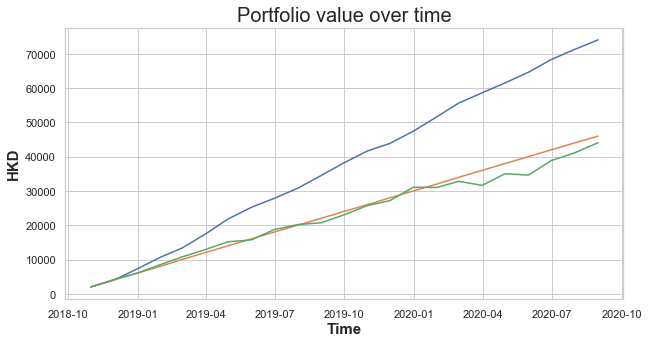

In [980]:
# Plot
x= result_graph_df.index
y= result_graph_df['Portfolio value']

sns.set(style="whitegrid", color_codes=True, font_scale = 1)
fig, ax = plt.subplots()
fig.set_size_inches(10,5)
plt.plot(x,y)
plt.plot(x,range(2000,48000,2000))
plt.plot(x,estimated_balace[:-1])
plt.xlabel('Time', fontsize=15, weight = 'bold')
plt.ylabel('HKD', fontsize=15, weight = 'bold')
plt.title('Portfolio value over time',fontsize=20)
plt.show()

# Compare with HSI

In [981]:
# validation_hsi_df
# Total return of the strategy
total_return_of_strategy = ((result_graph_df['Unit monthly return']+1).prod()-1)*100
total_std_of_strategy_return = (result_graph_df['Unit monthly return'].std())*100
print('The total return %% of the strategy is: %0.3f' %total_return_of_strategy)
print('The volatility %% of the strategy is: %0.3f' %total_std_of_strategy_return)
# Total return of HSI 
# validation_hsi_df.filter(regex='Return').mean()
total_return_of_hsi = ((validation_hsi_df.filter(regex='Return')[-24:]+1).prod()-1)*100
total_std_of_hsi_return = (validation_hsi_df.filter(regex='Return')[-24:].std())
print('The total return %% of the hsi is: %0.3f' %total_return_of_hsi)
print('The volatility %% of the strategy is: %0.3f' %total_std_of_hsi_return)

The total return % of the strategy is: 9.692
The volatility % of the strategy is: 4.436
The total return % of the hsi is: -15.580
The volatility % of the strategy is: 0.058


# Appendix 1: Details of each portfolio generation

In [27]:
# Calculation of select df period
number_of_portfolios = 5000
RF = 0.02  #According to the newest minimun ibond rate

portfolio_returns = []
portfolio_risk = []
sharpe_ratio_port = []
calmar_ratio_port = []
portfolio_weights = []

no_of_fund = len(fund_yearreturn.columns)
for portfolio in range (number_of_portfolios):
    weights = np.random.random_sample(no_of_fund)
    #below line ensures that the sum of our weights is 1
    weights = weights / np.sum(weights)
    
    period_return = np.sum(fund_yearreturn.mean() * weights)
    portfolio_returns.append(period_return)
    
    #variance
    matrix_covariance_portfolio = (fund_yearreturn.cov())
    portfolio_variance = np.dot(weights.T,np.dot(matrix_covariance_portfolio, weights))
    portfolio_standard_deviation= np.sqrt(portfolio_variance) 
    portfolio_risk.append(portfolio_standard_deviation)
    
    #sharpe_ratio
    sharpe_ratio = ((period_return- RF)/portfolio_standard_deviation)
    sharpe_ratio_port.append(sharpe_ratio)
    
    #Calmar_ratio
    max_dd = max_drawdown(fund_yearreturn)
    calmar_ratio = period_return / max_dd
    calmar_ratio_port.append(calmar_ratio) 
    
    portfolio_weights.append(weights)

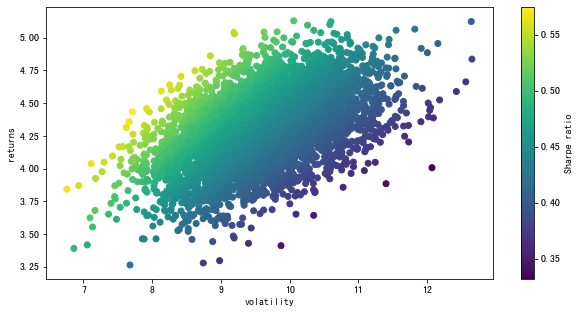

In [28]:
# Showchase of creating a efficient frontier
portfolio_risk = np.array(portfolio_risk)
portfolio_returns = np.array(portfolio_returns)
sharpe_ratio_port = np.array(sharpe_ratio_port)
calmar_ratio_port = np.array(calmar_ratio_port)
plt.figure(figsize=(10, 5))
plt.scatter(portfolio_risk, portfolio_returns, c=portfolio_returns / portfolio_risk) 
plt.xlabel('volatility')
plt.ylabel('returns')
plt.colorbar(label='Sharpe ratio')

In [38]:
porfolio_metrics = [portfolio_returns,portfolio_risk,sharpe_ratio_port,calmar_ratio_port, portfolio_weights] 

#from Python list we create a Pandas DataFrame
portfolio_dfs = pd.DataFrame(porfolio_metrics)
portfolio_dfs = portfolio_dfs.T

portfolio_dfs.columns = ['Portfolio Returns','Portfolio Risk','Sharpe Ratio','Calmar Ratio','Portfolio Weights']

In [43]:
porfolio_metrics = [portfolio_returns,portfolio_risk,sharpe_ratio_port, portfolio_weights] 
#from Python list we create a Pandas DataFrame
portfolio_dfs = pd.DataFrame(porfolio_metrics)
portfolio_dfs = portfolio_dfs.T
#Rename the columns:
portfolio_dfs.columns = ['Portfolio Returns','Portfolio Risk','Sharpe Ratio','Portfolio Weights']

#convert from object to float the first three columns.
for col in portfolio_dfs.columns[:-1]:
    portfolio_dfs[col] = portfolio_dfs[col].astype(float)
portfolio_dfs

,Portfolio Returns,Portfolio Risk,Sharpe Ratio,Portfolio Weights
0,4.538805,9.640964,0.263335,"[0.10075155320761854, 0.026299965530347854, 0...."
1,4.323572,11.411003,0.203626,"[0.029914402349878084, 0.029275536138865934, 0..."
2,3.983285,8.746781,0.226745,"[0.031168685260057345, 0.041365990763332285, 0..."
3,4.348825,10.568167,0.222255,"[0.012115738570204738, 0.07477528783601554, 0...."
4,4.476370,8.785085,0.281883,"[0.06358263920514509, 0.057775468400260974, 0...."
...,...,...,...,...
4995,4.633113,11.472143,0.229522,"[0.010439316390686694, 0.04927593444117291, 0...."
4996,4.642563,10.551023,0.250456,"[0.05595377557556178, 0.046773349534421416, 0...."
4997,4.129573,9.509091,0.223951,"[0.018997558165695975, 0.06330958996835555, 0...."
4998,4.419943,10.757520,0.224954,"[0.03894534201656181, 0.0007584304989027523, 0..."


In [52]:
#portfolio with the highest Sharpe Ratio
Highest_sharpe_port = portfolio_dfs.iloc[portfolio_dfs['Sharpe Ratio'].idxmax()]
#portfolio with the minimum risk 
min_risk = portfolio_dfs.iloc[portfolio_dfs['Portfolio Risk'].idxmin()]
Highest_return = portfolio_dfs.iloc[portfolio_dfs['Portfolio Returns'].idxmax()]

In [49]:
pd.DataFrame(min_risk)

,4670
Portfolio Returns,3.84188
Portfolio Risk,6.75931
Sharpe Ratio,0.272496
Portfolio Weights,"[0.0903921293206033, 0.001878798337954388, 0.0..."


In [51]:
pd.DataFrame(Highest_sharpe_port)

,4690
Portfolio Returns,5.04049
Portfolio Risk,9.18859
Sharpe Ratio,0.330898
Portfolio Weights,"[0.06606326063635035, 0.06506136858273344, 0.0..."


In [53]:
pd.DataFrame(Highest_return)

,4004
Portfolio Returns,5.12958
Portfolio Risk,10.0595
Sharpe Ratio,0.311108
Portfolio Weights,"[0.02775324357647931, 0.05275317530712749, 0.0..."
